In [9]:
import pandas as pd
from tqdm import tqdm

# Load the data into a DataFrame for easier processing
file_path = "test1/heap_write.log"

# Define a function to process and group data
def group_consecutive_addresses(file_path):
    # Read the file into a DataFrame
    df = pd.read_csv(
        file_path, 
        sep=r'\s+',  # Fixed to use a raw string
        header=None, 
        names=["Address", "Size", "Type", "Bitstring"]
    )
    
    # Convert the Address column to integers (base 16) and the Size column to integers
    df['Address'] = df['Address'].apply(lambda x: int(x, 16))
    df['Size'] = df['Size'].astype(int)
    
    # Initialize list to hold groups
    groups = []
    current_group = []
    
    # Iterate over rows and group consecutively
    for idx, row in tqdm(df.iterrows(), total=len(df), desc="Processing Rows", unit="row"):
        if not current_group:
            # If the group is empty, add the first row
            current_group.append(row)
        else:
            # Check if this row is consecutive with the previous one
            last_row = current_group[-1]
            if last_row['Address'] + last_row['Size'] == row['Address']:
                # If consecutive, add to the current group
                current_group.append(row)
            else:
                # Otherwise, push the current group to the list and start a new group
                groups.append(current_group)
                current_group = [row]
    
    # Add the last group if there is any remaining
    if current_group:
        groups.append(current_group)
    
    # Filter out groups where the total size is <= 16 bytes
    filtered_groups = [group for group in groups if sum(row['Size'] for row in group) > 16]
    
    # Sort groups by total size (descending order)
    filtered_groups.sort(key=lambda group: sum(row['Size'] for row in group), reverse=True)
    
    return filtered_groups

# Process the file and get the groups
filtered_groups = group_consecutive_addresses(file_path)

# Optionally, calculate and display the size of each group and the first address
for i, group in enumerate(filtered_groups):
    group_size = sum(row['Size'] for row in group)  # Sum the 'Size' column of the group
    first_address = group[0]['Address']  # First address in the group (first row)
    print(f"Group {i + 1}: First Address = 0x{first_address:X}, Total Size = {group_size} bytes")


Processing Rows: 100%|██████████| 4629125/4629125 [01:48<00:00, 42746.43row/s]


Group 1: First Address = 0x1D1C29D0, Total Size = 23040 bytes
Group 2: First Address = 0x1D1C8410, Total Size = 13312 bytes
Group 3: First Address = 0xA3C7040, Total Size = 4032 bytes
Group 4: First Address = 0xB263040, Total Size = 4032 bytes
Group 5: First Address = 0xEEC1040, Total Size = 4032 bytes
Group 6: First Address = 0x179E2040, Total Size = 4032 bytes
Group 7: First Address = 0x1810F040, Total Size = 4032 bytes
Group 8: First Address = 0x18169040, Total Size = 4032 bytes
Group 9: First Address = 0x1880E040, Total Size = 4032 bytes
Group 10: First Address = 0x1A0E0040, Total Size = 4032 bytes
Group 11: First Address = 0x1C3E1040, Total Size = 4032 bytes
Group 12: First Address = 0x839F080, Total Size = 3968 bytes
Group 13: First Address = 0xEB8B080, Total Size = 3968 bytes
Group 14: First Address = 0x1916B080, Total Size = 3968 bytes
Group 15: First Address = 0x610F0C0, Total Size = 3904 bytes
Group 16: First Address = 0x82F90C0, Total Size = 3904 bytes
Group 17: First Addres

There was 3 allocs in the biggest group first address:

```bash
grep "^0x1D1C29D0" /tmp/malloc.log
```

returns

```bash
0x1D1C29D0 23040
0x1D1C29D0 8224
0x1D1C29D0 8224
0x1D1C29D0 624
```

These are the first 100 stores

```bash
root@4e01d5464ae7:/opt/valgrind# awk '/^0x1D1C29D0/{f=1} f{print; c++; if(c==100) exit}' /tmp/heap_write.log
```

returns

0x1D1C29D0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000
0x1D1C29E0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C29F0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2A00 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2A10 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2A20 16 4366 00000000000000000000000000000111100000000000000000011110000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2A30 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2A40 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2A50 16 4366 00000000000000000000000000000011100000000000000000011100000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2A60 16 4366 00000000001111111000001100011000000111111000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2A70 16 4366 00000000000000000000000000000000000000000000000000000000000000000011111110000011111110000000000000000000000000000000000000000000
0x1D1C2A80 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2A90 16 4366 11100000000110000000000001100000000000000000000000000000000111110000001100011000011001111000000011100000000110000000000000110000
0x1D1C2AA0 16 4366 10000000111000000001100000000000001100000110011110000000000000000001100110000000111100000000110000000000001100000011000110000000
0x1D1C2AB0 16 4366 00000000000000000011110000001100000000110001100000001110000000001100000000000110000000000000000000000000000000110001100001100111
0x1D1C2AC0 16 4366 11100000000011000000000001100000000000000000000000000000000011110000000110011000001100111000000001110000000011000000000000110000
0x1D1C2AD0 16 4366 10000000111000000001100000000000001100000110011110000001100000000001100110000000111000000000110000000000001100000011000110000000
0x1D1C2AE0 16 4366 00011000110000000000000000011000000000110001100000001110000000001100000000000110000000000000000000000000000000110001100001100111
0x1D1C2AF0 16 4366 11000000000011100000000111000000000011000000000110000000000000000000000000000000000110001100001100011000000111111100001111111000
0x1D1C2B00 16 4366 10000011000110000011111110000011111110000000000000000000000000000001101100000000110110000001101100000001101100000000011000000000
0x1D1C2B10 16 4366 00110001100000110001100000001110000000001110000000011011000000011011000000000000000000000000000000000110000000000110000000110001
0x1D1C2B20 16 4366 11111000000110110000001100111000000000000000000000000000000011100000000011100000000011000000000000000000000001100000000001100000
0x1D1C2B30 16 4366 00000000111000000000000000000000000000000000000000000000011000000000000000000000000000000011000011000011000011000001111110000001
0x1D1C2B40 16 4366 00000000000000000000000000000000000000000000000000000000000000001100000000011000000000000000000000000000000000000000000000001110
0x1D1C2B50 16 4366 00000000000000000110000110110000000110110000000000000000000000000000000110000000000110000000000000000000000000000000000001111000
0x1D1C2B60 16 4366 00000000110000000000000000000000000000000110011000000110011000000011000110000011000110000011111110000011111110000000000000000000
0x1D1C2B70 16 4366 00000000000000000000000000001110000000001110000000001100000000001100000000011011000000001101100000000000000000000000000000011000
0x1D1C2B80 16 4366 11111000001101110000001101110000000000000000000000000000000110011000000110011000000000000000000000000000000110110000000110110000
0x1D1C2B90 16 4366 00000000111100000000000000000000000000000110011000000110011000000000111000000000111000000011000110000011000110000011111110000011
0x1D1C2BA0 16 4366 00000000000000011011000000011011000000000110000000000110000000001100000000001100000000011001100000001110000000001111000000001111
0x1D1C2BB0 16 4366 11000000001111111000000110110000000011100000001100110000000000000000000000000000000011011000000110110000000000000000000000000000
0x1D1C2BC0 16 4366 00000000110000000000000000000011011100000000000000000000111100000000011000000011000110000000000000000000000000000000001100000000
0x1D1C2BD0 16 4366 00000000000000000000000000000000000000011111100001000111111000000000000000110001111000000111111000111011100000110011000000001110
0x1D1C2BE0 16 4366 00000000000000000000000000000000000000000000000001000000000000000000000001100000000000000000000000000000000000000000000000000000
0x1D1C2BF0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2C00 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2C10 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2C20 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2C30 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2C40 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001100000
0x1D1C2C50 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2C60 16 4366 00001100000000001100000000011000000000001100000000011001100000011001100000000000000000000000000000000000000000000000000000000000
0x1D1C2C70 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001100000
0x1D1C2C80 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2C90 16 4366 00000000000000001100000000011000000000011000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2CA0 16 4366 00000000000000000000000000000000000110011000000000000000000000000000000000000000000110000000000000000000001100011000000000110000
0x1D1C2CB0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000011000011000000001100000001110000000000000000000000
0x1D1C2CC0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000110001100000000000000000000000000000000000000000000000
0x1D1C2CD0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2CE0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2CF0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2D00 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2D10 16 4366 00000000000000000001100000000000000000000011000110000000011000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2D20 16 4366 00000000000000110001100000000110000000001100000000000000000000000000000000000000000000000000000000011001100000000000000000000000
0x1D1C2D30 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2D40 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001100000000000000000
0x1D1C2D50 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2D60 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2D70 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2D80 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2D90 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2DA0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2DB0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2DC0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2DD0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000011000000000000000000000000000000000000000000000
0x1D1C2DE0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2DF0 16 4366 00000000000000000000000000000000011100000000000001110000000000000000011100000000000011100000000000000000000000000000000000000000
0x1D1C2E00 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2E10 16 4366 00000000000000000000000000000000000000000000000000001100000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2E20 16 4366 11000000000000111111000000000000111111111111111111000000000000111111000000000000111111111111111111000000000000111111000000000000
0x1D1C2E30 16 4366 11110000000000001111111111111111110000000000001111110000000000001111111111111111110000000000001111110000000000001111111111111111
0x1D1C2E40 16 4366 11111111111111111100000000000011111100000000000011111111111111111100000000000011111100000000000011111111111111111100000000000011
0x1D1C2E50 16 4366 11000000000000011111000000000000011111011111011111000000000000011111000000000000011111011111011111000000000000011111000000000000
0x1D1C2E60 16 4366 11110000000000000111110111110111110000000000000111110000000000001111110111110111110000000000000111110000000000000111110111110111
0x1D1C2E70 16 4366 01111101111101111100000000000001111100000000000001111101111101111100000000000001111100000000000001111101111101111100000000000001
0x1D1C2E80 16 4366 11000000000000111111000000000000111111111111111111000000000000111111000000000000111111111111111111000000000000111111000000000000
0x1D1C2E90 16 4366 11110000000000001111111111111111110000000000001111110000000000001111111111111111110000000000001111110000000000001111111111111111
0x1D1C2EA0 16 4366 11111111111111111100000000000011111100000000000011111111111111111100000000000011111100000000000011111111111111111100000000000011
0x1D1C2EB0 16 4366 11000000000000011111000000000000011111011111011111000000000000011111000000000000011111011111011111000000000000011111000000000000
11000000001111111
0x1D1C2F70 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000011000000000000000000000000000000000000000000000000000000
0x1D1C2F80 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2F90 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2FA0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2FB0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2FC0 16 4366 00000000000000000000000000001111000000000000000000111100000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2FD0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2FE0 16 4366 00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C2FF0 16 4366 00000000000000000000000000000111000000000000000000111000000000000000000000000000000000000000000000000000000000000000000000000000
0x1D1C3000 16 4366 00000000011111110000011000110000001111110000000000000000000000000000000000000000000000000000000000000000000000000000000000000000

In [12]:
# Assume `filtered_groups` contains the groups already filtered and sorted.

# Step 1: Take the first group
first_group = filtered_groups[0]

# Step 2: Divide the bitstring into 4 parts and create a list of 32-bit segments
bitstrings_32_bits = []

for row in first_group:
    bitstring = row['Bitstring']
    
    # Split the bitstring into 4 parts of 32 bits each (assuming the bitstring is long enough)
    bitstring_parts = [bitstring[i:i+32] for i in range(0, len(bitstring), 32)]
    
    # Ensure there are exactly 4 parts (pad if necessary)
    while len(bitstring_parts) < 4:
        bitstring_parts.append('0' * 32)  # Padding with '0's
    
    # Add the 32-bit parts to the list
    bitstrings_32_bits.extend(bitstring_parts)

# Step 3: Write the list of 32-bit segments to a .alloc file
alloc_file_path = "bitstrings.alloc"
with open(alloc_file_path, 'w') as f:
    for bits in bitstrings_32_bits:
        f.write(bits + '\n')  # Write each 32-bit segment on a new line

print(f"32-bit segments have been written to {alloc_file_path}")


32-bit segments have been written to bitstrings.alloc


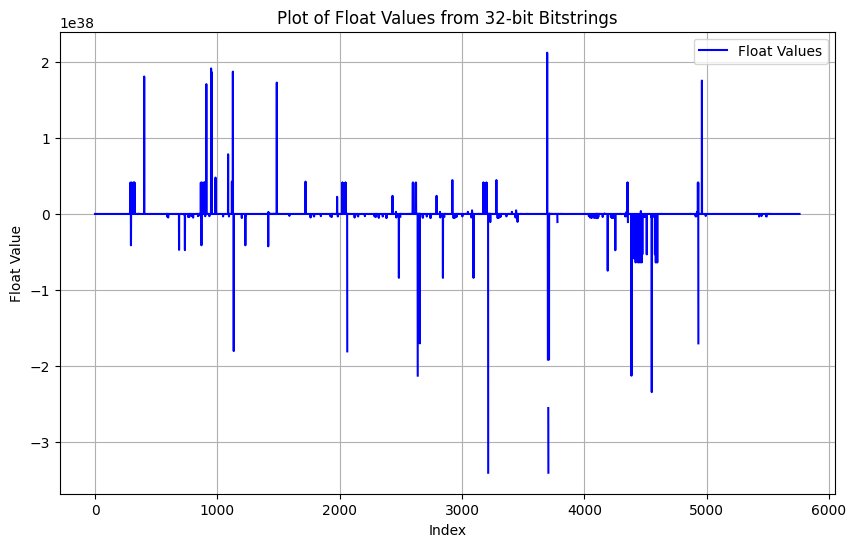

In [14]:
import struct
import matplotlib.pyplot as plt

# Step 1: Read the bitstrings from the bitstrings.alloc file
alloc_file_path = "bitstrings.alloc"
bitstrings_32_bits = []

with open(alloc_file_path, 'r') as f:
    bitstrings_32_bits = f.readlines()

# Step 2: Convert the 32-bit bitstrings to float values
float_values = []

for bitstring in bitstrings_32_bits:
    bitstring = bitstring.strip()  # Remove any newline or trailing spaces
    int_value = int(bitstring, 2)  # Convert the binary string to an integer
    float_value = struct.unpack('f', struct.pack('I', int_value))[0]  # Convert integer to float using IEEE 754 format
    float_values.append(float_value)

# Step 3: Plot the float values
plt.figure(figsize=(10, 6))
plt.plot(range(len(float_values)), float_values, label="Float Values", color='b')
plt.xlabel('Index')
plt.ylabel('Float Value')
plt.title('Plot of Float Values from 32-bit Bitstrings')
plt.grid(True)
plt.legend()
plt.show()
